In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import lines
import sympy as sy
from sympy import Symbol, solve
import random
from tqdm import tqdm

c:\Users\shins\Anaconda3\envs\HyperImaging\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# device='cpu'
device='cuda'

#### Projector sensor coordinate

In [3]:
# proj params
focal_length_proj = 8e-3 # proj intrinsic * pitch
sensor_diag_proj = 5.842e-3
sensor_width_proj = np.sin(np.arctan2(720, 1280))*sensor_diag_proj 
N_proj = 720
R,C = 720, 720
proj_pitch = sensor_width_proj / N_proj

# proj sensor x,y,z
xs = torch.linspace(0, R-1, steps= R)
ys = torch.linspace(0, C-1, steps=C)
c, r = torch.meshgrid(xs, ys, indexing= 'ij')

In [4]:
# proj x,y,z to world coord
x_c, y_c = (r-N_proj/2)*proj_pitch, (c-N_proj/2)*proj_pitch

z_c = torch.zeros_like(x_c)
z_c[:] = -focal_length_proj

# (0,0,0) proj_sensor_center
proj_sensor_cen = torch.zeros(size=(4,1))
proj_sensor_cen[3,0] = 1

# reshape to 720*720
x_c,y_c,z_c = x_c.flatten(), y_c.flatten(), z_c.flatten() # 720*720

# make xyz1 vector
xyz1 = torch.stack((x_c,y_c,z_c, torch.ones_like(x_c)), dim = 1).transpose(0,1)

#### Create diffraction gratings extrinsic matrix

In [5]:
# rotation, translation matrix
extrinsic_diff = torch.zeros((4,4))

# rotation
rot = torch.tensor([1,1,1])
extrinsic_diff[0,0] = rot[0]
extrinsic_diff[1,1] = rot[1]
extrinsic_diff[2,2] = rot[2]

# translate
trans = torch.tensor([0,0,10*1e-3])
extrinsic_diff[0,3] = trans[0]
extrinsic_diff[1,3] = trans[1]
extrinsic_diff[2,3] = trans[2]
extrinsic_diff[3,3] = 1

### Change to diffraction gratings coordinate

In [6]:
# change projector sensor to diffraction gratings coordinate
proj_sensor_dg = torch.linalg.inv(extrinsic_diff)@xyz1
proj_sensor_dg = proj_sensor_dg[:3]

# change center to dg coordinate
proj_center_dg = torch.linalg.inv(extrinsic_diff)@proj_sensor_cen
proj_center_dg = proj_center_dg[:3]

# incident light Direction vectors
incident_dir = proj_center_dg[:] - proj_sensor_dg[:,:]

In [7]:
# normal vector, aplha, beta vector
n_vec = torch.tensor([[0,0,1]])
alpha_vec = torch.tensor([[1,0,0]])
beta_vec = torch.tensor([[0,1,0]])

#### Incident direction unit vector

In [8]:
# making to unit vector
x, y, z = incident_dir[0,:], incident_dir[1,:], incident_dir[2,:]
norm = np.sqrt(x**2+y**2+z**2)

# incident light unit direction vector
incident_dir_unit = incident_dir[:,:] / norm[:]

In [9]:
# find intersection points

def find_intersection(proj_center_dg, incident_dir_unit):
    a = torch.zeros_like(incident_dir_unit)

    for i in range(len(incident_dir_unit[0])):
        t = -proj_center_dg[2,0]/incident_dir_unit[2,i]
        a[:,i] = t*incident_dir_unit[:,i] + proj_center_dg[:,0]
    
    return a

intersection_points = find_intersection(proj_center_dg,incident_dir_unit)
intersection_points = intersection_points.reshape(3,R,C)

#### alpha_i and beta_i

cosine of alpha-axis and incident light unit direction vector

cosine of beta-axis and incident light unit direction vector

In [10]:
# alpha_i lefts only x coords
alpha_i = incident_dir_unit[0,:]

# beta_i lefts only y coords
beta_i = incident_dir_unit[1,:]

In [11]:
def get_alpha_m(m, alpha_i, lmbda):
    d = (1/500)*1e-3
    alpha_m = - m*lmbda/d + alpha_i
    
    return alpha_m

def get_beta_m(m, beta_i):
    beta_m = beta_i

    return beta_m

def get_z_m(alpha_m, beta_m):
    z = np.sqrt(1 - alpha_m**2 - beta_m**2)

    return z

In [12]:
# find virtual projector center

def intersect(P,dir):
    """P and dir are NxD arrays defining N lines.
    D is the dimension of the space. This function 
    returns the least squares intersection of the N
    lines from the system given by eq. 13 in 
    http://cal.cs.illinois.edu/~johannes/research/LS_line_intersect.pdf.
    """
    # generate the array of all projectors 
    projs = np.eye(dir.shape[1]) - dir[:,:,np.newaxis]*dir[:,np.newaxis]  # I - n*n.T
    # see fig. 1 

    # generate R matrix and q vector
    R = projs.sum(axis=0)
    q = (projs @ P[:,:,np.newaxis]).sum(axis=0)

    # solve the least squares problem for the 
    # intersection point p: Rp = q
    p = np.linalg.lstsq(R,q,rcond=None)[0]

    return p


In [13]:
from scipy.io import savemat, loadmat
from os import makedirs
from os.path import exists, join

m_list = [-1,0,1]
# lmb = list(np.linspace(450, 700, 11)*1e-9)
lmb = list(np.linspace(400, 780, 77)*1e-9)

dat_path = './dat/'
if not exists(dat_path):
    makedirs(dat_path)

for m in tqdm((m_list)):
    for i in tqdm(range(len(lmb)), leave=False):

        # compute direction cosines
        alpha_m = get_alpha_m(alpha_i=alpha_i, m=m, lmbda=lmb[i])
        beta_m = get_beta_m(beta_i=beta_i, m=m)
        z = get_z_m(alpha_m, beta_m)

        alpha_m = alpha_m.reshape(R,C)
        beta_m = beta_m.reshape(R,C)
        z = z.reshape(R,C)

        # diffracted unit vector
        diffracted_dir_unit = torch.stack((alpha_m,beta_m,z), dim = 0)  

        # # diffracted light line segment
        # diffracted_unit = diffracted_dir_unit + intersection_points

        intersection_points_r = intersection_points.reshape(3,R*C)
        diffracted_dir_unit_r = diffracted_dir_unit.reshape(3,R*C)

        # virtual projector pixels 
        sensor_z = proj_sensor_dg[2,:].mean()  # new sensor's z location
        start = [intersection_points_r[0,:],intersection_points_r[1,:],intersection_points_r[2,:]]

        scale_sensor = (sensor_z-start[2])/z.flatten()
        sensor_X_virtual = start[0] + scale_sensor*alpha_m.flatten()
        sensor_Y_virtual = start[1] + scale_sensor*beta_m.flatten()
        sensor_Z_virtual = start[2] + scale_sensor*z.flatten()

        # optical_center_virtual : virtual project's center
        p = intersection_points_r.data.numpy().T
        d = diffracted_dir_unit_r.data.numpy().T
        optical_center_virtual = intersect(p,d)
        optical_center_virtual = torch.tensor(optical_center_virtual, dtype=torch.float32)

        # # Make grating coordinate to projector coordinate (NOT NEEDED)
        # # extrinsic 
        # extrinsic_proj_real_toproj = extrinsic_proj_real
        # extrinsic_proj_real_toproj[:,3] = trans.squeeze()
        # extrinsic_proj_real_toproj

        # ones = torch.tensor([[1]])
        # xyz_param_cpu1 = torch.cat((xyz_param_cpu, ones), dim = 0)
        # proj_center_dg1 = torch.cat((proj_center_dg, ones), dim = 0) # real proj center

        # # rotation, translation matrix
        # extrinsic_proj_virtual = torch.zeros((4,4))

        # # rotation
        # rot = torch.tensor([1,1,1])
        # extrinsic_proj_virtual[0,0] = rot[0]
        # extrinsic_proj_virtual[1,1] = rot[1]
        # extrinsic_proj_virtual[2,2] = rot[2]

        # # translate
        # optical_center_virtual = extrinsic_proj_real_toproj@xyz_param_cpu1
        # optical_center_proj = extrinsic_proj_real_toproj@proj_center_dg1

        optical_center_proj = proj_center_dg

        # trans = optical_center_virtual - optical_center_proj[:3]
        # extrinsic_proj_virtual[0,3] = trans[0]
        # extrinsic_proj_virtual[1,3] = trans[1]
        # extrinsic_proj_virtual[2,3] = trans[2]
        # extrinsic_proj_virtual[3,3] = 1

        # intrinsic of virtual projector
        focal_length_proj_virtual = (optical_center_virtual[2] - sensor_Z_virtual.mean()).abs()
        cx_proj_virtual = sensor_X_virtual.mean() - optical_center_virtual[0]
        cy_proj_virtual = sensor_Y_virtual.mean() - optical_center_virtual[1]

        # extrinsic_proj_virtual = [rot_proj, optical_center_virtual - optical_center_proj; 0, 0, 0, 1]
        intrinsic_proj_virtual = torch.tensor([[focal_length_proj_virtual, 0, cx_proj_virtual], 
                                                [0, focal_length_proj_virtual, cy_proj_virtual],
                                                [0,0,1]])
                                                
        # real coordinates
        sensor_X_real = proj_sensor_dg[0,:]
        sensor_Y_real = proj_sensor_dg[1,:]
        sensor_Z_real = proj_sensor_dg[2,:]

        # save coordinates for fitting
        sensor_X_virtual = sensor_X_virtual.reshape(R,C)
        sensor_Y_virtual = sensor_Y_virtual.reshape(R,C)
        sensor_X_real = sensor_X_real.reshape(R,C)
        sensor_Y_real = sensor_Y_real.reshape(R,C)

        # save virtual projector's sensor x & y coordinates and real projector's sensor x & y coordinates
        savemat(join(dat_path, 'dispersion_coordinates_m%d_wvl%d.mat'%(m, lmb[i]*1e9 )), {'x': sensor_X_virtual.data.cpu().numpy(), 'y':sensor_Y_virtual.data.cpu().numpy(), 'xo': sensor_X_real.data.cpu().numpy(), 'yo': sensor_Y_real.data.cpu().numpy()})

100%|██████████| 3/3 [00:25<00:00,  8.67s/it]


In [14]:
# distortion function

def distort_func(x, y, p, q, N = 5): # p = p[:,0], q = p[:,1]
    
    cnt=0
    x_d, y_d = torch.zeros_like(x), torch.zeros_like(y)
    
    for n in range(N+1): # 0,1,2,3,4,5
        # for each degree n
        for i in range(n+1):
            # 
            x_d += p[cnt]*(x**(n-i))*(y**(i))
            y_d += q[cnt]*(x**(n-i))*(y**(i))
            cnt += 1
    # x_d = p00 + p10*x + p01*y + p20*(x**2) + p11*x*y + p02*(y**2) + p30*(x**3) + p21*(x**2)*y + p12*x*(y**2) + p03*(y**3) + p40*(x**4) + p31*(x**3)*y + p22*(x**2)*(y**2) + p13*x*(y**3) + p04*(y**4) + p50*(x**5) + p41*(x**4)*y + p32*(x**3)*(y**2) + p23*(x**2)*(y**3) + p14*x*(y**4) + p05*(y**5)
    # y_d = q00 + q10*x + q01*y + q20*(x**2) + q11*x*y + q02*(y**2) + q30*(x**3) + q21*(x**2)*y + q12*x*(y**2) + q03*(y**3) + q40*(x**4) + q31*(x**3)*y + q22*(x**2)*(y**2) + q13*x*(y**3) + q04*(y**4) + q50*(x**5) + q41*(x**4)*y + q32*(x**3)*(y**2) + q23*(x**2)*(y**3) + q14*x*(y**4) + q05*(y**5)

    return x_d, y_d

# Run image_formation_dispersion_fit.m 

100%|██████████| 3/3 [00:19<00:00,  6.64s/it]


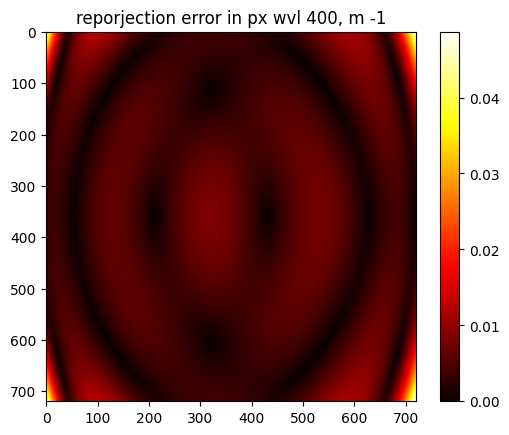

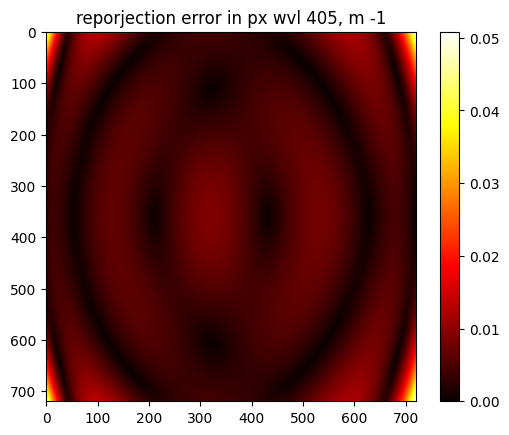

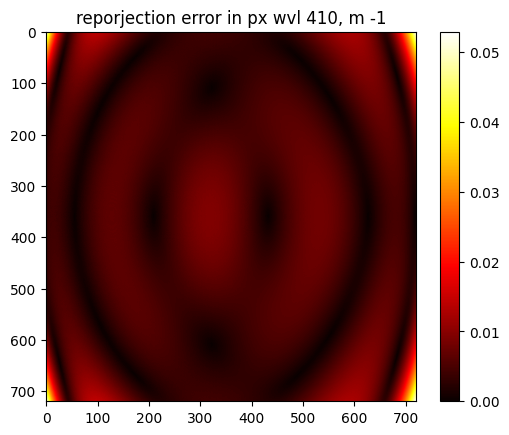

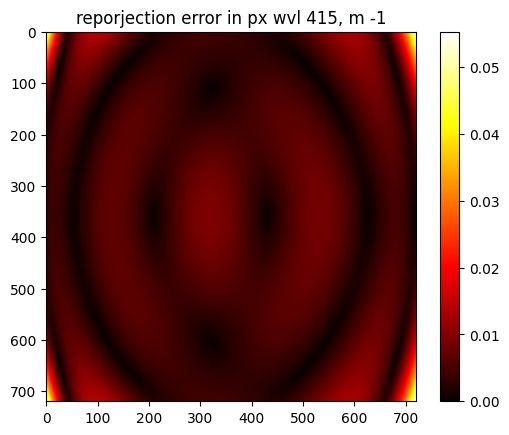

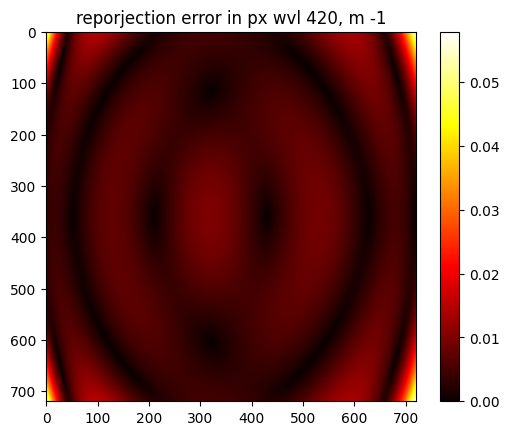

...

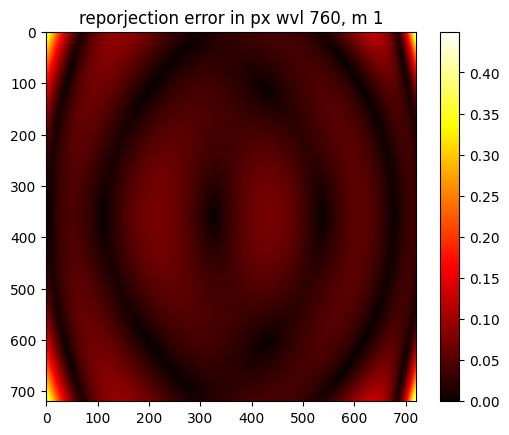

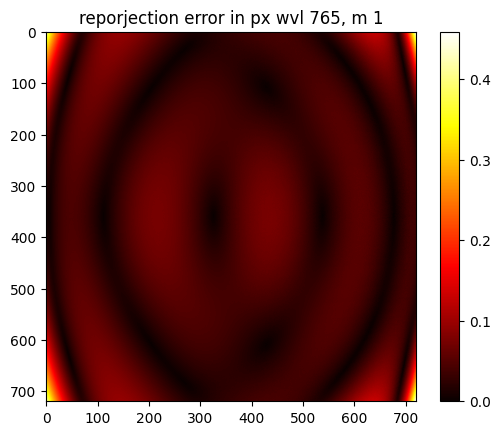

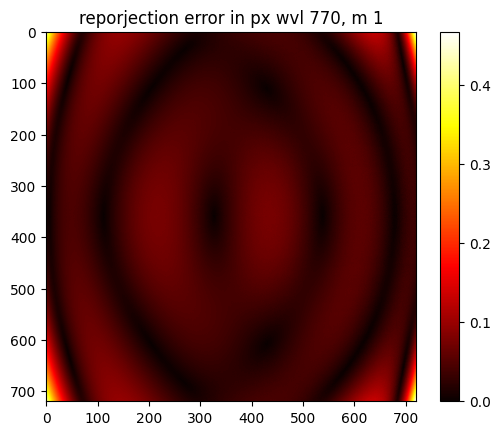

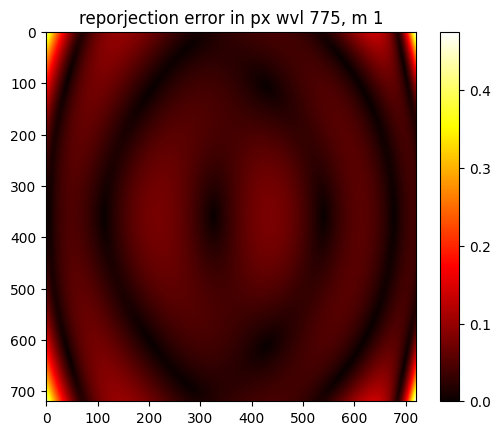

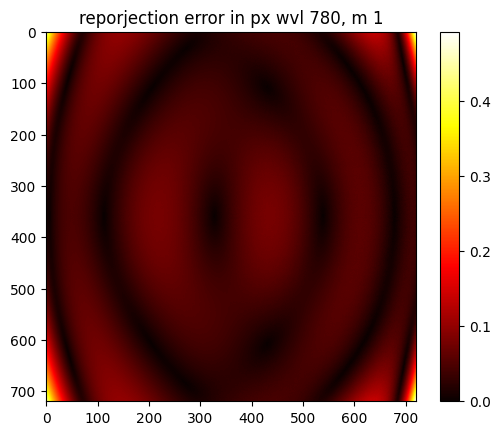

In [16]:
for m in tqdm((m_list)):
    for i in tqdm(range(len(lmb)), leave=False):
        
        # load the distortion parameters
        p = loadmat(join(dat_path, 'param_dispersion_coordinates_m%d_wvl%d.mat'%(m, lmb[i]*1e9 )))
        p = p['p']
        p_dist = torch.tensor(p, dtype=torch.float32, device=device).T

        # load the input/output parameters
        dat = loadmat(join(dat_path, 'dispersion_coordinates_m%d_wvl%d.mat'%(m, lmb[i]*1e9 )))
        sensor_X_virtual, sensor_Y_virtual, sensor_X_real, sensor_Y_real = torch.tensor(dat['x']), torch.tensor(dat['y']), torch.tensor(dat['xo']), torch.tensor(dat['yo'])
        sensor_X_virtual = sensor_X_virtual.to(device)
        sensor_Y_virtual = sensor_Y_virtual.to(device)
        sensor_X_real = sensor_X_real.to(device)
        sensor_Y_real = sensor_Y_real.to(device)

        # test the distortion parameters
        sensor_X_virtual_distorted, sensor_Y_virtual_distorted =  distort_func(sensor_X_virtual, sensor_Y_virtual, p_dist[:,0], p_dist[:,1])

        # compute error
        reprojection_error_x = (sensor_X_real - sensor_X_virtual_distorted).data.cpu().numpy()
        reprojection_error_y = (sensor_Y_real - sensor_Y_virtual_distorted).data.cpu().numpy()
        reprojection_error_px = ((reprojection_error_x**2 + reprojection_error_y**2)**0.5)/proj_pitch

        plt.figure()
        plt.imshow(reprojection_error_px, cmap='hot', vmin=0, vmax=np.abs(reprojection_error_px).max())
        plt.colorbar()
        plt.title('reporjection error in px wvl %d, m %d'%(lmb[i]*1e9, m))   

# Image formation

### Depth 가져오기

In [ ]:
# bring depth

import os,OpenEXR,Imath

output_dir = "C:/Users/shins/HyperImaging/Dataset/data/result"

def read_exr_as_np(i, rendertype):
        """  Read exr file(rgb rendered obj scene) as numpy array
        
        exr file shape RGBA 640x640x4
        return : numpy array        
        """
        
        fn = os.listdir(output_dir)
        fn = [file for file in fn if rendertype in file]
        
        fn = os.path.join(output_dir, fn[i])

        f = OpenEXR.InputFile(fn)
        channels = f.header()['channels']
 
        dw = f.header()['dataWindow']
        size = (dw.max.x - dw.min.x + 1, dw.max.y - dw.min.y + 1)

        ch_names = []

        image = np.zeros((size[1], size[0], len(channels)-1))

        for i, ch_name in enumerate(channels):
            ch_names.append(ch_name)
            ch_dtype = channels[ch_name].type
            ch_str = f.channel(ch_name, ch_dtype)

            if ch_dtype == Imath.PixelType(Imath.PixelType.FLOAT):
                np_dtype = np.float32

            image_ch = np.fromstring(ch_str, dtype=np_dtype)
            image_ch.shape = (size[1], size[0])

            if ch_name == "A" :
                continue
            else:
                image[:,:,3-i] = image_ch
        
        return image

## Cam intrinsic 

In [ ]:
N = 640
sensor_width = 5.32e-3 
focal_length = 16e-3
cam_pitch = sensor_width/N

In [ ]:
def depth(i):
    dist = read_exr_as_np(i,"Depth").astype(np.float32)
    dist = dist[...,0]

    # cam intrinsic
    N = 640
    sensor_width = 5.32e-3 
    focal_length = 16e-3

    x, y = torch.meshgrid(torch.linspace(-sensor_width/2,sensor_width/2,N), torch.linspace(-sensor_width/2,sensor_width/2,N))

    depth = focal_length*dist/(torch.sqrt(x**2 + y**2 + focal_length**2))
    depth *= 10 
    
    return depth

In [ ]:
depth = depth(0)

c:\Users\shins\Anaconda3\envs\HyperImaging\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
c:\Users\shins\Anaconda3\envs\HyperImaging\lib\site-packages\torch\functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:2895.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
def unprojection(depth):
    # cam intrinsic
    N = 640
    sensor_width = 5.32e-3 
    focal_length = 16e-3
    cam_pitch = sensor_width/N

    c,r = torch.meshgrid(torch.linspace(0,N-1,N), torch.linspace(0,N-1,N), indexing='ij') # 행렬 indexing

    x_c, y_c = (r-N/2)*cam_pitch, (c-N/2)*cam_pitch
    z_c = torch.zeros_like(x_c)
    z_c[:] = focal_length

    X,Y,Z = -x_c/focal_length*depth, -y_c/focal_length*depth, -depth

    return X,Y,Z

In [ ]:
# cam coords to world coord (in world coord)

X,Y,Z = unprojection(depth=depth)

In [ ]:
X.shape

torch.Size([640, 640])

## Change Coordinate

In [ ]:
# X,Y,Z in world coordinate
# x_c, y_c, z_c in world coordinate

In [ ]:
# world coordinate to real proj's coordinate

extrinsic_proj_real = torch.zeros((4,4))
# no rotation
extrinsic_proj_real[0,0] = 1 
extrinsic_proj_real[1,1] = 1
extrinsic_proj_real[2,2] = 1

# translate + x 50e-3
extrinsic_proj_real[0,3] = 50e-3 
extrinsic_proj_real[3,3] = 1

# real proj intrinsic matrix
focal_length_proj = 8e-3 # proj intrinsic * pitch
sensor_diag_proj = 5.842e-3
sensor_width_proj = np.sin(np.arctan2(720, 1280))*sensor_diag_proj  # height
N_proj = 720
proj_pitch = sensor_width_proj/N_proj

In [ ]:
# virtual projector's intrinsic & extrinsic matrix (real proj to virtual proj's coordinate)
intrinsic_proj_virtual

extrinsic_proj_virtual = torch.zeros((4,4))
# rotation
rot = torch.tensor([1,1,1])
extrinsic_proj_virtual[0,0] = rot[0]
extrinsic_proj_virtual[1,1] = rot[1]
extrinsic_proj_virtual[2,2] = rot[2]

trans = optical_center_virtual - optical_center_proj[:3]
extrinsic_proj_virtual[0,3] = trans[0]
extrinsic_proj_virtual[1,3] = trans[1]
extrinsic_proj_virtual[2,3] = trans[2]
extrinsic_proj_virtual[3,3] = 1


In [ ]:
# real proj's coordinate to diffraction gratings coordinate extrinsic matrix
# rotation, translation matrix
extrinsic_diff

tensor([[1.0000, 0.0000, 0.0000, 0.0000],
        [0.0000, 1.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 1.0000, 0.0100],
        [0.0000, 0.0000, 0.0000, 1.0000]])

In [ ]:
torch.set_printoptions(precision = 8)

In [ ]:
# project world coordinates onto virtual projector

def projection(X,Y,Z, vproj, rproj):
    X,Y,Z = X.flatten(), Y.flatten(), Z.flatten()
    XYZ1 = torch.stack((X,Y,Z,torch.ones_like(X)), dim = 0)

    # XYZ coords in virtual proj's coordinate
    XYZ_vir = torch.linalg.inv(vproj)@torch.linalg.inv(rproj)@XYZ1
    XYZ_vir = XYZ_vir[:3]
    
    xy_virtual_proj = (-focal_length_proj_virtual*XYZ_vir[:2,:]/XYZ_vir[2,:])

    return xy_virtual_proj


In [ ]:
# project world coordinates onto virtual projector (in virtual proj's coord)
xy_vproj = projection(X,Y,Z, extrinsic_proj_virtual, extrinsic_proj_real)

In [ ]:
# vproj to dg coord
def vproj_to_dg(xy_vproj, vproj, dg):
    ones = torch.ones_like(xy_vproj[0,:])
    z_vproj = torch.zeros_like(xy_vproj[0,:])
    z_vproj[:] = -sensor_Z_virtual.mean()
    
    xyz1_vproj = torch.stack((xy_vproj[0,:], xy_vproj[1,:],z, ones), dim = 0)

    xyz_dg = torch.linalg.inv(dg)@vproj@xyz1_vproj
    xy_dg = xyz_dg[:2]

    return xy_dg

xy_dg = vproj_to_dg(xy_vproj, extrinsic_proj_virtual, extrinsic_diff)

In [ ]:
sensor_X_vir, sensor_Y_vir = xy_dg[0,:], xy_dg[1,:]
sensor_X_vir, sensor_Y_vir = sensor_X_vir.to(device), sensor_Y_vir.to(device)

In [ ]:
sensor_x_real, sensor_y_real = distort_func(sensor_X_vir, sensor_Y_vir, p_dist[:,0], p_dist[:,1])

In [ ]:
sensor_x_real = sensor_x_real/proj_pitch + N_proj/2
sensor_x_real = sensor_x_real.data.cpu()

In [ ]:
sensor_y_real = sensor_y_real/proj_pitch + N_proj/2
sensor_y_real = sensor_y_real.data.cpu()

In [ ]:
sensor_x_real

tensor([ -200.43560791,  -202.04443359,  -203.57379150,  ...,
        -1800.51147461, -1804.87353516, -1809.24365234])

## Pseudocode for hyperspectral-depth image formation

Once we know the virtual projector paremeters for all wavelengths and diffraction orders, we can project any scene point to a virtual projector, where its correspondence to the original projector's sensor plane Virtual projector's extrinsic, intrinsic, distortion parameters

1. Input: Depth map Z, camera parameters

2. Unproject the depth map into a 3D coordinate (X,Y,Z)

3. Compute the projector x,y coordinates (x,y) on a virtual projector corresponding to a diffraction order m and a wavelength lambda

4. Compute the coordinates (x',y') on a real projector via a calibrated polymonial mapping function

In [ ]:
# diffraction order and wavelengths
mlist = [-1, 0, 1]
wvls = torch.linspace(430, 660, 5, device=device)

m_N = len(mlist)
wvls_N = len(wvls)

# calibrated projector and camera CRFs
CRF_cam = torch.zeros((wvls_N, 3))  
CRF_proj = torch.zeros((wvls_N, 3))

# projector RGB illumination image (this is the optimization parameter)
illum = torch.zeros((R, C, 3)) 
illum[R//4:R//3, C//4:C//3] = 1

# projector hyperspectral illumination image 
illum_hyp = illum.reshape((R*C, 3))@CRF_proj.T
illum_hyp = illum_hyp.reshape((R,C,wvls_N))

# diffracted illumination image projected to a scene and captured by the camera 
illums_w_occ = torch.zeros((m_N, R, C, wvls_N))


for m_i, m in enumerate(mlist):
    for wvl_i, wvl in enumerate(wvls):

        # virtual projector's center 
        vproj = vprojs[m_i, wvl_i]  

        # bring depth
        depth = self.depth(i)

        # unproject to world coord from cam sensor
        X,Y,Z = self.unprojection(depth= depth)

        # project the world coordinates onto the virtual projector
        xy_vproj = projection(X,Y,Z, vproj) 

        # map virtual coordinates to real coordinates
        xy_proj =  dist_proj_virtual(xy_vproj, p_dist[:,0], p_dist[:,1])
        rc_proj = xy_proj/proj_pitch + rc_proj_center

        # illumination 
        illum_img = illum_hyp[rc_proj[:,:,1].long(), rc_proj[:,:,0].long(), wvl_i]

        # multiply with occlusion
        occ = self.bring_occ(i)
        illum_w_occ = illum_img * occ

        # shading term
        view_vec = unit_vector(cam_center-XYZ)
        illum_vec = unit_vector(vproj-XYZ)
        shading = (illum_vec*view_vec).sum(axis=-1)

        # final pattern
        illums_w_occ[m_i, :, :, wvl_i] = illum_w_occ*shading

# image formation 
hyp_img = torch.zeros((cam_R, cam_C, len(wvls)), device=device)
cam_m_img = torch.zeros((m_N, cam_R, cam_C, 3), device=device)

for i in range(m_N):
    cam_m_img[i] = (hyp_img*illums_w_occ[i] @ CRF_cam)

cam_img = cam_m_img.sum(axis=0)